<a href="https://colab.research.google.com/github/datacommonsorg/api-python/blob/master/notebooks/COVID_19_Feature_Exploration_Analysis_with_Data_Commons.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Copyright 2020 Google LLC.
SPDX-License-Identifier: Apache-2.0

**Authors**: Yi Gao, Xianzhi Helen Wang

# Welcome!

Welcome to this Colab notebook! We will walk you through two examples of exploration analyses with the Data Commons dataset here:

1. How do the COVID-19 cases trends differ across different counties?
2. What features are potentially correlated with COVID-19 mortality rate? 

We hope the examples can help you better understand what data are available on Data Commons and how to use them, so that further research or analysis can be conducted easily.

**More about the dataset used in this Colab**

The analyses here use a frozen version of the data set which was generated around mid July, 2020. 
* For COVID-19 case data, we fix the analysis period as 2020-02-26 to 2020-07-10 so that the results in this Colab are reproducible. (The start date is chosen since it's the time of the first instance of community spread as reported [here](https://www.cdc.gov/media/releases/2020/s0226-COVID-19-spread.html).)
* For context data, they are the most recent values at the time when this data set was generated (2020-07-15). More details about the context features' definition can be found on Data Commons ([link](http://docs.datacommons.org/statistical_variables.html)).

You can find live versions of the data sets in the <a href='#scrollTo=yl2NOcuSmVUu'>Appendix section</a> of this Colab.

Hope you enjoy the exploratory analysis here!

# Prepare

## Load Packages

In [1]:
!pip install -U plotly

import json
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import random
import seaborn as sns
import statsmodels.api as sm

from collections import defaultdict
from datetime import datetime
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import silhouette_score
from urllib.request import urlopen

# This is used for map plots.
counties_geo_path = 'https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json'
with urlopen(counties_geo_path) as response:
    COUNTIES_GEO = json.load(response)

pd.set_option('max_colwidth', 400)


     |████████████████████████████████| 13.0MB 323kB/s 
  Found existing installation: plotly 4.4.1
    Uninstalling plotly-4.4.1:
      Successfully uninstalled plotly-4.4.1


/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



## Load and join data sets

In [2]:
# The Google files are in this Google Drive Folder:
# https://drive.google.com/drive/u/1/folders/1mM1scQxsD38tlSk7IcSKJrN7Ez5-J22F

analysis_data_start = datetime.strptime('2020-02-26', '%Y-%m-%d')
analysis_data_end = datetime.strptime('2020-07-10', '%Y-%m-%d')
date_range =  pd.date_range(analysis_data_start, analysis_data_end).format(
    formatter=lambda x: x.strftime('%Y-%m-%d'))
count_data_columns = ['County', 'Name'] + date_range

STATE_COVARIATE_PATH = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vR12v_MRKdDa6u2mdD0aPFlDilV0SJtbeYyrNbqI3qZDuImw_RnDcpNAmwbJkRP7O7fAC-9EYsoV4Dm/pub?output=csv'
df_state_context = pd.read_csv(STATE_COVARIATE_PATH)
COUNTY_COVARIATE_PATH = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vSSeYEVT9wH-F6X7qxnhyXke1JoudkpqAJqVdZWlkTLF0Ah5529VDB4gLLICrqpczbvl-qi_P7Eyte7/pub?output=csv'
df_county_context = pd.read_csv(COUNTY_COVARIATE_PATH)

COUNTY_POSITIVE_COUNT_PATH = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vSv2PsEqsv4wyVUG9F3SCBMgMm9vXQg05a_Hyjc7xw5uOmlNUFYSg75JxvRQ3yuHodoZMFcK_FB1J3H/pub?output=csv'
df_county_case = pd.read_csv(COUNTY_POSITIVE_COUNT_PATH)
df_county_case = df_county_case[count_data_columns]

COUNTY_DEATH_COUNT_PATH = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vRqhlJ7yAGMEJtnS8-8BISwB7ZfB9WyHFtOpbGe5v_hVmUHXvkXyJCXCDX-jp8u6KC-SdbVBs4c78aI/pub?output=csv'
df_county_death = pd.read_csv(COUNTY_DEATH_COUNT_PATH)
df_county_death = df_county_death[count_data_columns]

In [3]:
# Create geoid - county / state name mapping.
df_county_name = df_county_context[['County', 'Name']].copy()
df_county_name['State'] = df_county_name['County'].apply(lambda x: x[:-3])
df_county_name = pd.merge(df_county_name, df_state_context[['State', 'Name']],
                          on='State', suffixes=('_county', '_state'))
df_county_name['full_name'] = df_county_name['Name_county'] + ', '+ \
  df_county_name['Name_state']

county_name_mapping = defaultdict(str)
for _, row in df_county_name.iterrows():
  county_name_mapping[row['County']] = row['full_name']

def get_name_by_geoid(geoid):
  return county_name_mapping[geoid]

In [4]:
# Merge the county level DataFrames.
df_county_joined = pd.merge(df_county_case, df_county_death, how='outer', 
                            suffixes=('_case', '_death'), 
                            on=['County', 'Name']).pipe(
                                pd.merge,right=df_county_context, how='outer')
df_county_joined = df_county_joined.set_index('County')
df_county_joined = df_county_joined.join(df_county_name)

case_columns = [date + '_case' for date in date_range]
death_columns = [date + '_death' for date in date_range]

In [5]:
# Check the shapes of the loaded DataFrames
print(f'The shape of df_state_context is {df_state_context.shape}.')
print(f'The shape of df_county_context is {df_county_context.shape}.')
print(f'The shape of df_county_case is {df_county_case.shape}.')
print(f'The shape of df_county_death is {df_county_death.shape}.')
print(f'The shape of df_county_joined is {df_county_joined.shape}.')

The shape of df_state_context is (52, 192).
The shape of df_county_context is (3190, 182).
The shape of df_county_case is (3076, 138).
The shape of df_county_death is (3138, 138).
The shape of df_county_joined is (3258, 458).


# How do COVID-19 cases trends differ across different counties?

In this section, we give an example of discovering different case trends across counties. 

Here are the main steps in this example:
1. Calculate normalized case trends.
2. Cluster the counties of similar case growth patterns.
3. Visualize the main trend of each cluster.
4. Visualize the clustering result on the U.S. map.



## Calculate normalized trends

The positive case counts available in DataCommons are cumulative counts. In this part, we calculate daily incremental case counts and normalize them by population, so that trends can be compared between different counties. 

**Technical detail**

We will cluster the counties by their smoothed trends of incremental positive cases normalized by population: 

$$\frac{\#\ of\ incremental\ positive\ cases}{county\ population}.$$

The $\#\ of\ incremental\ positive\ cases$ is the number of new cases diagnosed with COVID-19 on each day in each county. We want to look at incremental changes instead of the cumulative trends because it's easier to distinguish / interpret incremental change patterns (which can go up / down) compared to cumulative trend patterns (which all go up).

The incremental cases are normalized by population as we expect to see higher case numbers in counties with more people. Simply clustering the counties using the incremental case numbers will possibly generate clusters just reflecting county populations. After the normalization, we can have the numbers that are roughly comparable among the counties, regardless of their population, so that the clustering results can better reflect the severity of the counties.

In addition, the trends are smoothed with centered 7-day moving average to adjust for weekday effects.

We will see what are the main trend patterns during the analysis period and how they are distributed in the U.S.

In [6]:
def obtain_incremental_trend(df, count_columns, smooth=True, clip=True):
  """Obtains the normalized incremental changes.

     The input df contains cumulative counts of interest, and this function
     calculates normalized incremental changes from that df.

  Args:
    df: A data frame with joined data.
    count_columns: Columns in the joined data dataframe specifying the columns
      of cumulative counts. They should have the format YYYY-MM-DD_[case|death].
    smooth: Whether to take rolling averages of the counts. If True, the output
      will be 7-day centered rolling averages of incremental changes in each
      county. Otherwise the raw incremental trends will be returned. Note that
      first 3 days and last 3 days will be removed if smooth=True.
    clip: Whether to replace negative incremental changes as 0.
  
  Returns:
    A dataframe with dates as index and county geoId as columns names. Each
    column is a series of incremental changes in the county.
  """
  trends = df[count_columns].apply(lambda x: x / df['Count_Person'])
  trends = trends.transpose()
  trends.index = pd.to_datetime([idx.split('_')[0] for idx in trends.index])
  trends = trends.dropna(axis=1, how='all')
  trend_changes = trends.sort_index().diff()
  # Some incremental changes of cumulative positive cases are negative, and this
  # is an issue existing in the source data (JHU dataset) we are using. We 
  # simply replace the negative ones as 0 here.
  if clip:
    trend_changes = trend_changes.clip(lower=0.)
  if smooth:
    trend_changes = trend_changes.apply(
        lambda x: x.rolling(7,center=True).mean())
  return trend_changes.dropna()

case_incremental_trends = obtain_incremental_trend(df_county_joined,
                                                   case_columns)

## Cluster the counties

After preparing the trend data, we run a K-means algorithm to cluster the counties into 9 clusters. The cluster labels are ordered so that smaller labels indicate larger cluster sizes.

**Technical detail**

The number of clusters, 9, is decided in this <a href='#scrollTo=U0eXxDRRpBE1'>Appendix section</a>.

In [7]:
def get_cluster_labels(trend_df, n_cluster, **kmeans_kwargs):
  """Generates cluster labels for data containing incremental trends.
     
  Args:
    trend_df: A dataframe containing incremental trends generated from the 
      function 'obtain_incremental_trend'.
    n_cluster: The number of clusters desired.
    random_seed: A random seed to fix the results of the k-means algorithm.
    **kmeans_kwargs: Named arguments passed to the KMeans function.

  Returns:
    A data frame with two columns. The first column 'County' contains the
    geoIds and the second column 'Cluster' contains the cluster labels. The
    cluster labels are ordered so that clusters with smaller labels are larger
    clusters containing more conties.
  """
  cluster_data_df = trend_df.transpose()
  km_model = KMeans(n_clusters=n_cluster, **kmeans_kwargs).fit(cluster_data_df)
  cluster_labels = pd.DataFrame({
      'County': trend_df.columns,
      'Cluster': km_model.predict(cluster_data_df)})
  cluster_counts = cluster_labels['Cluster'].value_counts().sort_values(
      ascending=False)
  new_cluster_mapping = {cluster_counts.index[i]: i for
                         i in range(len(cluster_counts))}
  cluster_labels['Cluster'] = cluster_labels['Cluster'].apply(
      lambda x: new_cluster_mapping[x])
  return cluster_labels

case_cluster_labels = get_cluster_labels(case_incremental_trends, 9,
                                         random_state=42, n_init=1000)


## Check the main trend of each cluster

The median trend values of the clusters are shown below. (The shadow area is specified by 2.5%-tile and 97.5%-tile values in each cluster on each day.) A few clusters are very small because they are essentially 'outliers' in the data set. The first few clusters are of special interest:

* Cluster '0' is the counties with low case ratio over the whole analysis period.
* Cluster '1' is the counties where new case ratio started to increase after June.
* Cluster '2' is the severe counties during April and May.
* Cluster '3' is the very severe counties where new cases peaked in early June and then dropped.
* Cluster '4' is the very severe counties where new cases peaked in early May and then dropped.
* Cluster 5-8 are basically some 'outliers'.

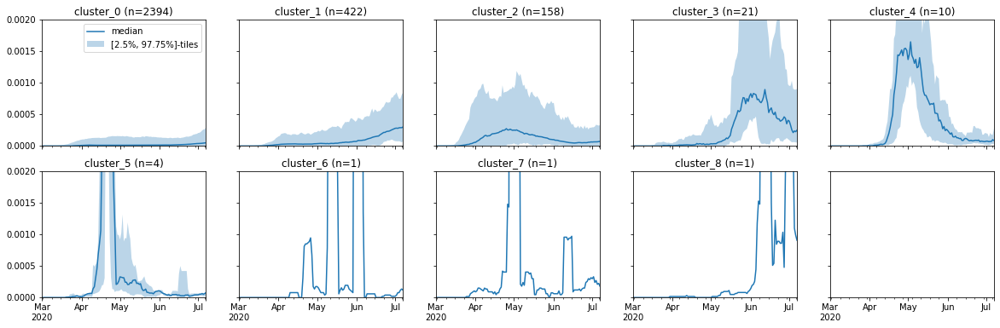

In [8]:
def plot_cluster_medians(rate_df, label_df, nc=5, ylim=None):
  """Plots cluster medians with bounds of 2.5 and 97.5 percentiles.

  Args:
    rate_df: The dataframe containing incremental rates.
    label_df: The dataframe containing cluster labels of each county.
    nc: The number of columns in the output plot.
    ylim: The y-limits of the plots.

  Returns:
    A dataframe containing the median trends of the clusters. A group of trend
    plots with median trends with bounds of 2.5 and 97.5 percentiles is plotted.
  """
  n_cluster = label_df['Cluster'].nunique()
  nr = int(np.ceil(n_cluster / nc))
  fig, ax = plt.subplots(nr, nc, sharex=True, sharey=True, figsize=[20, 3*nr])
  ax = ax.flatten()
  all_trend = pd.DataFrame()
  if ylim is None:
    ylim = [0, rate_df.max().max()]
  for i, cluster in enumerate(sorted(label_df['Cluster'].unique())):
    temp_county = label_df[label_df['Cluster'] == cluster]['County'].values
    temp_rates = rate_df[temp_county]
    temp_stats = temp_rates.transpose().describe(percentiles=[0.025, 0.975])
    up_bound = temp_stats.loc['97.5%']
    low_bound = temp_stats.loc['2.5%']
    median_trend = temp_stats.loc['50%']
    all_trend[f'cluster_{i}'] = median_trend
    median_trend.plot(ax=ax[i], label='median')
    ax[i].set_title(f'cluster_{i} (n={len(temp_county)})')
    ax[i].fill_between(median_trend.index, low_bound.values, up_bound.values, 
                       alpha=0.3, label='[2.5%, 97.75%]-tiles')
    ax[i].set_ylim(ylim)
    if i==0:
      ax[i].legend()
  return all_trend

median_case_trends = plot_cluster_medians(case_incremental_trends,
                                          case_cluster_labels, ylim=[0, 0.002])

## Geographical distribution of the clusters

Plot the heatmap of the distribution of the different trend patterns.

In [9]:
def norm_by_range(x):
  """Normalizes an array by it's range.

  Args:
    x: an array or a pd.Series.

  Returns:
    A normalized array or pd.Series whose values are normalized to the range
    between 0 and 1.
    
  """
  return (x - x.min()) / (x.max() - x.min())

def show_values_on_map(values, title, adjust_cmap=False, **kwargs):
  """Shows the values associated with counties on a U.S. map.

  Args:
    values: A pd.Series containing the values of interest indexed by county geo
      IDs. The values can either be strings or numbers. Strings will be
      interpreted as groups and numbers will be used as continuous values.
    title: The title of the plot.
    adjust_cmap: Whether to adjust the color map. Only set this as True for
      numerical values. It will adjust the color scale so that the the plot is
      not influenced by severe outliers.
    **kwargs: Other key-value arguments passed to px.choropleth.
    
  Returns:
    A plotly.graph_objs._figure.Figure project.
  """
  plot_df = pd.DataFrame({
      'county': values.index,
      'value': values.values
  })
  plot_df['full_name'] = plot_df['county'].apply(get_name_by_geoid)
  plot_df['fips'] = plot_df['county'].apply(lambda x: x.split('/')[1])
  if adjust_cmap:
    value_describe = plot_df['value'].describe(
      percentiles=[0.01, 0.99])[['min','1%', '50%', '99%', 'max']]
    value_describe_norm = norm_by_range(value_describe)
    new_color_scale = [(0, 'green'), 
                      (value_describe_norm['1%'], 'green'),
                      (value_describe_norm['50%'], 'white'),
                      (value_describe_norm['99%'], 'orange'),
                      (1, 'orange')]
    fig = px.choropleth(plot_df, locations='fips', geojson=COUNTIES_GEO, 
                      color='value', scope="usa",
                      hover_data=['full_name'],
                      color_continuous_scale=new_color_scale,
                      title=title, **kwargs)
  else:
    fig = px.choropleth(plot_df, locations='fips', geojson=COUNTIES_GEO, 
                      color='value', scope="usa",
                      hover_data=['full_name'],
                      title=title, **kwargs)
  return fig

str_cluster_labels = case_cluster_labels.sort_values(
    'Cluster').set_index('County')['Cluster'].apply(lambda x: f'cluster_{x}')
color_sequence = ['#2ca02c', '#ff7f0e', '#9467bd', '#8c564b', '#1f77b4',
                  '#d62728', '#17becf', '#bcbd22', '#7f7f7f']
show_values_on_map(str_cluster_labels, 'Case trend cluster distribution',
                         color_discrete_sequence = color_sequence)

# What features are potentially correlated with COVID-19 mortality rate?

In this example, we will explore the available context features and demonstrate two simple approaches (pairwise correlation / logistic regression) to discover features with potentially high correlation with the COVID-19 mortality rate.

Main steps in this analysis:
1. Context feature cleaning
2. Death ratio calculation
3. Pairwise correlation analysis
4. Logistic regression with PCA components

## Context feature cleaning

It's usually necesary to clean up a data set before using it. In this part, we normalized / transform variables and imopute missing values so that we can easily use them for the following analysis.

**Technical details**

* Given the purpose of our next step is to use these variables to better understand death-to-case ratio, most of features on raw counts are not very helpful. We need to have normalized counts for the counties so that we can compare. Here we simply devide all the counts by county's populations. A prefix 'Norm_' is added to such variables.
* The distribution of some features are highly skewed. We take a log transformation for these variables:
  * log transformation for Count_Person, LandAreaSqMeter, PopulationDensityPerSqMeter.
* Deal with missing values:
  * Features with > 40% missing values are dropped.
  * Missing values of each county are filled by the its state median. If a value is missed for all counties in a state, they are filled by the median of all available states.

In [10]:
features_updated = df_county_context.drop('Name', axis=1).copy()

# Normalized count variables by population.
# The variable names are updated to have prefix 'Norm_Count_'. The reason we
# we don't use 'percent' here because some counts are not about 'person', for
# example, 'Count_Household_With3Person'. Normalized version of these features
# are not percentages. Although the new variables have the term 'count' in it,
# they are no longer 'counts', but actually 'ratios'.
count_feature_columns = [c for c in df_county_context if 
                         c.startswith('Count_') and c != 'Count_Person']
population_col = df_county_context['Count_Person']
retaildrug_cols = [c for c in df_county_context if 
                   c.startswith('RetailDrugDistribution_')]
for c in count_feature_columns + retaildrug_cols:
  features_updated['Norm_' + c] = df_county_context[c] / population_col

# The feature Percent_NoHealthInsurance_AmongUpto64Years is a little confusing:
# It's the percent of people up to 64 years without insurance among all people.
# We normalize it by percent of people up to 64 years.
features_updated['Percent_NoHealthInsurance_AmongUpto64Years'] = \
  features_updated['Percent_Person_Upto64Years_NoHealthInsurance'] / \
  (1 - features_updated['Norm_Count_Person_65OrMoreYears'])

# Take log for some features (population, area, retail drug distribution etc.)
features_updated['Log_Count_Person'] = np.log(df_county_context['Count_Person'])
features_updated['Log_LandAreaSqMeter'] = np.log(
    df_county_context['LandAreaSqMeter'])
features_updated['Log_PopulationDensityPerSqMeter'] = np.log(
    features_updated['PopulationDensityPerSqMeter'])

# Remove the raw count variables.
features_updated = features_updated.drop(
    count_feature_columns + retaildrug_cols + [
      'Count_Person', 'LandAreaSqMeter', 'PercentBlackOrAfricanAmericanAlone',
      'UnemploymentRate_Person', 'PopulationDensityPerSqMeter',
      'Percent_Person_Upto64Years_NoHealthInsurance'], axis=1)

# Remove columns with >40% missing values
col_missing_ratio = features_updated.apply(
  lambda x: sum(x.isna()) * 1. / len(x))
col_remove = col_missing_ratio[col_missing_ratio > 0.4].index.values
features_updated = features_updated.drop(col_remove, axis=1)

# Augment missing values
features_updated['State'] = features_updated['County'].apply(lambda x: x[:-3])
state_medians = features_updated.groupby('State').apply(lambda x: x.median())
state_medians = state_medians.apply(lambda x: np.where(x.isna(), x.median(), x))
for c in features_updated.columns:
  if c in ['County', 'State']:
    continue
  features_updated[c] = np.where(
      features_updated[c].isna(),
      state_medians.loc[features_updated['State']][c],
      features_updated[c]
  )

features_updated = features_updated.drop('State', axis=1).set_index('County')

## Death ratio calculation

Death ratios are calculated as the ratio between total death cases devided by total positive cases for each county. 

Counties with total case counts < 10 are removed from this analysis.

In [11]:
case_counts = df_county_joined[case_columns]
death_counts = df_county_joined[death_columns]

death_ratio = death_counts.max(axis=1) / case_counts.max(axis=1)
death_ratio = death_ratio[case_counts.max(axis=1) >= 10]
death_ratio = death_ratio[death_ratio < 1].dropna()
death_ratio = pd.DataFrame(death_ratio).reset_index()
death_ratio.columns = ['County', 'death_ratio']
death_ratio = death_ratio.set_index('County')

In [12]:
show_values_on_map(death_ratio['death_ratio'], 'Death ratio distribution', True)

## Pairwise correlation analysis

We show the pairwise correlation among the context features and death ratio is plotted in the heatmap below. We also list the top features with largest correlation with death ratio.

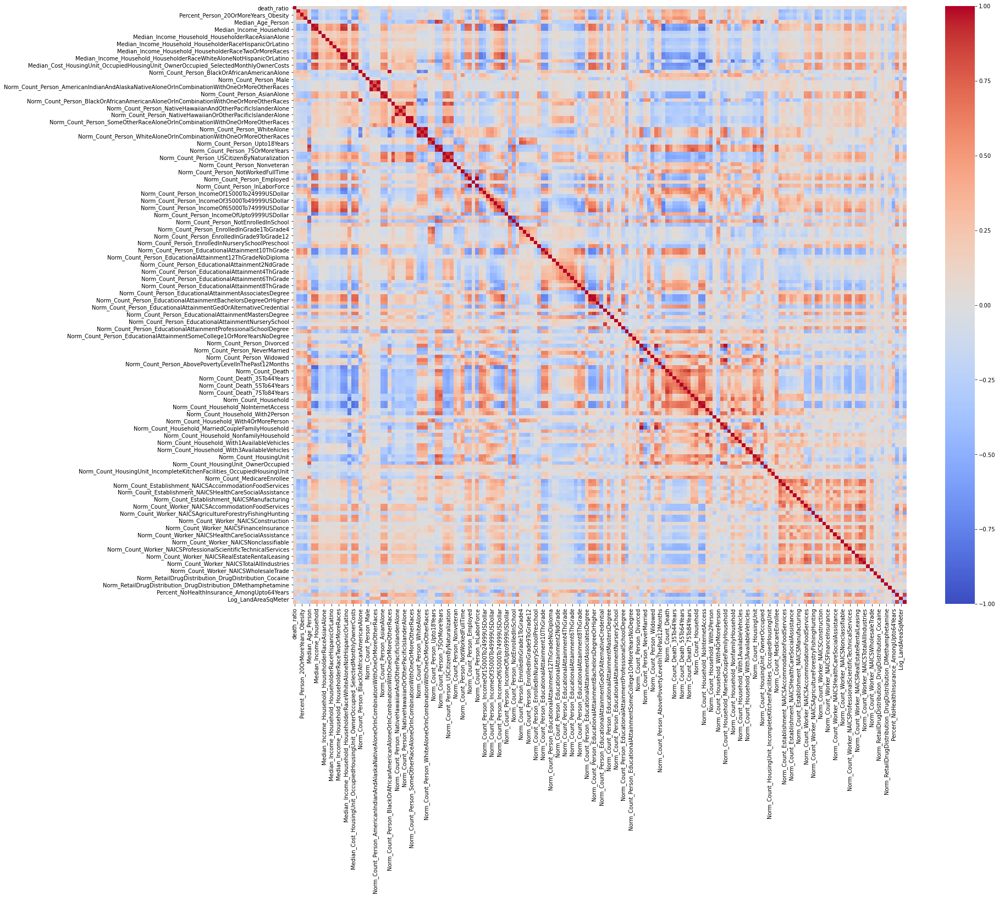

In [13]:
df_death_ratio_joined = death_ratio.join(
    features_updated, how='inner'
)
corr_full = df_death_ratio_joined.corr('spearman')
fig, _ = plt.subplots(figsize=(25,20))
sns.heatmap(corr_full, cmap='coolwarm', vmin=-1, vmax=1)

In [14]:
df_corr = corr_full[['death_ratio']].drop('death_ratio')
df_corr.columns = ['corr']
df_corr['abs_corr'] = abs(df_corr['corr'])

sorted_corr = df_corr.sort_values(['abs_corr'], ascending=False)
sorted_corr.head(5)

,corr,abs_corr
Log_PopulationDensityPerSqMeter,0.282678,0.282678
Log_Count_Person,0.261947,0.261947
Norm_Count_Person_BlackOrAfricanAmericanAloneOrInCombinationWithOneOrMoreOtherRaces,0.231868,0.231868
Norm_Count_Person_BlackOrAfricanAmericanAlone,0.226728,0.226728
Norm_Count_Household_With3Person,0.195454,0.195454


### Deep dive for population density

You can use density plot to better understand the relationship between a context feature and the death ratio. A visulization of the values on map would be helpful, too. Here we use population density as an example to generate those plots.

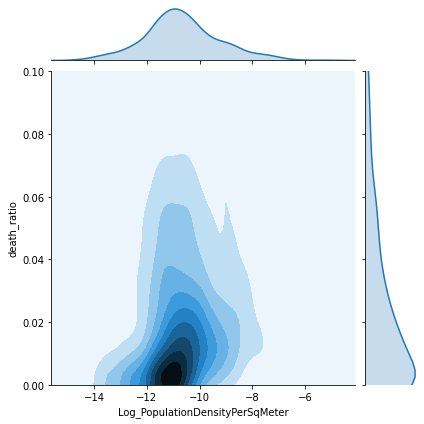

In [15]:
sns.jointplot(data=df_death_ratio_joined,
              x='Log_PopulationDensityPerSqMeter', 
              y='death_ratio', kind='kde', ylim=[0, 0.1])

In [16]:
show_values_on_map(features_updated['Log_PopulationDensityPerSqMeter'], 
                   'Log population density', True)

## Logistic regression with PCA

Here we demonstrate another approach to discover useful features by using a logistic regression with components generated from PCA (principle component analysis).

### Principle Component Analysis

The main purpose of PCA is to reduce the number of features by combining similar features. After this step, we will use 15 components generated from PCA instead of the set of ~165 features. 

**Technical details**

We have lots of features (~165) in the data set. This could introduce misleading results for further analysis. For example, if we identify variables with significant effect with alpha=5%, we would expect about 8 'significant' features as false positive. In order to deal with it, we conduct a PCA to combine similar features.

All variables are normalized between [0, 1] before PCA. The explained variance vs number of principle components are plotted. We choose 15 components for further analysis as the curve starts to be flat after that.

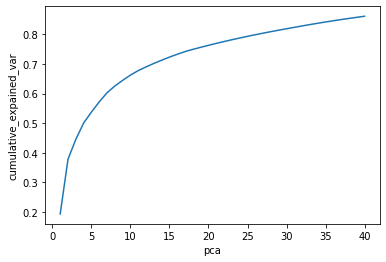

In [17]:
features_norm = features_updated.apply(norm_by_range)

pca_full = PCA(n_components=40).fit(features_norm)
pca_var = pd.Series(pca_full.explained_variance_ratio_, 
                    index=range(1, 41), name='explained_var')
ax = pca_var.cumsum().plot()
ax.set_xlabel('pca')
ax.set_ylabel('cumulative_expained_var')

pca_n = 15
pca = PCA(n_components=pca_n).fit(features_norm)
county_pcas = pd.DataFrame(features_norm.dot(pca.components_.transpose()))
county_pcas.columns = [f'pca_{i}' for i in range(1, pca_n+1)]

#### How to interpret a PCA component?

A PCA component can be understood as a weighted sum of a list of features. The meaning of the PCA is mainly decided by the few features with highest weights. 

For example, the top features with most weights in first PCA component are shown below. You can also visualize it on the U.S. map to have a better understanding of its distribution.

In [18]:
pca_weights = pd.DataFrame(pca.components_,
                           index=[f'pca_{i}' for i in range(1, pca_n+1)],
                           columns=features_norm.columns)

def get_top_features(compo_weights, top_n=3):
  """Gets top features for a component from its weight.

  Args:
    compo_weights: A series containing features weights of a component, indexed
      by the feature names.
    top_n: Show the top_n features of the component.

  Returns:
    A dataframe with three columns:
      rank: The rank of the feature in the list.
      top_feature: The name of the feature.
      weight: The weight of the feature.
  """
  abs_weights = abs(compo_weights)
  top_n_compos = abs_weights.sort_values(ascending=False).index.values[: top_n]
  return pd.DataFrame({
      'rank': range(1, top_n+1),
      'top_feature': top_n_compos,
      'weight': compo_weights[top_n_compos].values},
      index=range(1, top_n+1))

top_compos_df = pd.DataFrame(columns=['pca', 'rank', 'top_feature', 'weight'])
for i, row in pca_weights.iterrows():
  temp_top_compo = get_top_features(row)
  temp_top_compo['pca'] = i
  top_compos_df = top_compos_df.append(temp_top_compo)
top_copos_df = top_compos_df[['pca', 'rank', 'top_feature', 'weight']]

pca_of_interest = 'pca_1'
top_copos_df.query(f'pca=="{pca_of_interest}"')

,pca,rank,top_feature,weight
1,pca_1,1,Norm_Count_Person_WhiteAloneNotHispanicOrLatino,-0.262586
2,pca_1,2,Norm_Count_HousingUnit_OwnerOccupied,-0.185548
3,pca_1,3,Norm_Count_Household_With2Person,-0.185315


In [19]:
show_values_on_map(county_pcas['pca_1'], 'PCA_1 distrubtion', True)

### Logistic regression

We use a logistic model to find which PCA components are most correlated with death ratio. We rank the PCA components by their p-values. The smaller p-value indicates stronger relationship between the PCA components and the death ratio.

**Technical details**

The model is specified as:
$$logit(P(death|positive)) = \theta X,$$
where $X$ is the features of interest.

When training the model, each observation is a positive case associated with the corresponding county-level components, and the dependent variable is whether the patient died or not.



In [20]:
total_case_counts = df_county_joined[case_columns].max(axis=1)
total_death_counts = df_county_joined[death_columns].max(axis=1)

# recover binary data for logistic regression.
death_data = pd.DataFrame({'case': total_case_counts,
                           'death': total_death_counts},
             index=total_case_counts.index).dropna()
death_data = death_data[death_data['case'] >= 10]
death_data['survival'] = death_data['case'] - death_data['death']
death_data = death_data.drop('case', axis=1)
death_data = death_data.clip(lower=0)

def run_logistic_model(death_data, features=county_pcas):
  """Fits a logistic model to get feature coefficients.

  Args:
    death_data: A dataframe with two columns 'death' and 'survival', indexed by
      county geo IDs.
    features: A dataframe containing the features used for this analysis,
      indexed by county geo IDs.
  
  Returns:
    A list of two objects:
      * A data frame indexed by feature names, containing the corresponding 
        p-value and coefficients.
      * The fitted model.
  """
  joined_data = features.join(death_data, how='inner')
  X = sm.add_constant(joined_data.drop(['death', 'survival'], axis=1))
  y = joined_data[['death', 'survival']].values
  
  observed_cases = joined_data['death'] + joined_data['survival']
  glm = sm.GLM(y, X, sm.families.Binomial())
  res = glm.fit()
  
  coefs = pd.DataFrame({
      'p-value': res.pvalues,
      'coef': res.params}, index=X.columns).sort_values('p-value')
  return coefs, res

logistic_coef, logistic_model = run_logistic_model(death_data, county_pcas)
logistic_coef.head(5)

,p-value,coef
const,0.000000e+00,-6.665520
pca_3,0.000000e+00,0.730977
pca_6,0.000000e+00,-1.758059
pca_9,0.000000e+00,1.882122
pca_5,1.217416e-172,-0.919432


# Appendix

## How to load live data set?

You can directly query Data Commons for the latest COVID-19 and covariate data. Note that most covariate sources are not updated as frequently as COVID-19 sources.

In [21]:
!pip install datacommons_pandas
import datacommons_pandas as dc

     |████████████████████████████████| 81kB 1.9MB/s 


In [29]:
# COVID-19 cases and deaths for state and county.
df_state_positive = dc.build_time_series_dataframe(df_state_context['State'], 'CumulativeCount_MedicalTest_ConditionCOVID_19_Positive', desc_col=True)
df_state_deaths = dc.build_time_series_dataframe(df_state_context['State'], 'CumulativeCount_MedicalConditionIncident_COVID_19_PatientDeceased', desc_col=True)

df_county_positive = dc.build_time_series_dataframe(df_county_context['County'], 'CumulativeCount_MedicalTest_ConditionCOVID_19_Positive', desc_col=True)
df_county_deaths = dc.build_time_series_dataframe(df_county_context['County'], 'CumulativeCount_MedicalConditionIncident_COVID_19_PatientDeceased', desc_col=True)

df_county_deaths.head()

,2020-09-16,2020-09-15,2020-09-14,2020-09-13,2020-09-12,2020-09-11,2020-09-10,2020-09-09,2020-09-08,2020-09-07,2020-09-06,2020-09-05,2020-09-04,2020-09-03,2020-09-02,2020-09-01,2020-08-31,2020-08-30,2020-08-29,2020-08-28,2020-08-27,2020-08-26,2020-08-25,2020-08-24,2020-08-23,2020-08-22,2020-08-21,2020-08-20,2020-08-19,2020-08-18,2020-08-17,2020-08-16,2020-08-15,2020-08-14,2020-08-13,2020-08-12,2020-08-11,2020-08-10,2020-08-09,2020-08-08,...,2020-02-29,2020-02-28,2020-02-27,2020-02-26,2020-02-25,2020-02-24,2020-02-23,2020-02-22,2020-02-21,2020-02-20,2020-02-19,2020-02-18,2020-02-17,2020-02-16,2020-02-15,2020-02-14,2020-02-13,2020-02-12,2020-02-11,2020-02-10,2020-02-09,2020-02-08,2020-02-07,2020-02-06,2020-02-05,2020-02-04,2020-02-03,2020-02-02,2020-02-01,2020-01-31,2020-01-30,2020-01-29,2020-01-28,2020-01-27,2020-01-26,2020-01-25,2020-01-24,2020-01-23,2020-01-22,2020-01-21
place,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
geoId/01001,24,24,24,24,24,24,24,24.0,24.0,24.0,24.0,24.0,24.0,24.0,24.0,24.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,23.0,22.0,22.0,22.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
geoId/01003,47,47,47,47,47,47,46,46.0,46.0,46.0,46.0,46.0,46.0,44.0,42.0,42.0,42.0,40.0,40.0,39.0,37.0,36.0,35.0,35.0,35.0,35.0,35.0,34.0,33.0,33.0,32.0,32.0,32.0,32.0,32.0,32.0,32.0,28.0,27.0,26.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
geoId/01005,7,7,7,7,7,7,7,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,5.0,5.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
geoId/01007,9,9,9,9,9,9,9,9.0,9.0,9.0,9.0,9.0,9.0,8.0,8.0,8.0,8.0,7.0,7.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,5.0,5.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
geoId/01009,13,13,13,13,13,12,12,12.0,12.0,12.0,12.0,12.0,12.0,11.0,11.0,11.0,11.0,10.0,9.0,9.0,7.0,7.0,6.0,6.0,6.0,6.0,6.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,4.0,4.0,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [23]:
# State covariates
df_state = dc.build_multivariate_dataframe(df_state_context['State'], df_state_context.columns[2:])
df_state.head()

,Count_Person_BlackOrAfricanAmericanAloneOrInCombinationWithOneOrMoreOtherRaces,Count_Person_InLaborForce,Count_Person_IncomeOf75000OrMoreUSDollar,Count_Person_EducationalAttainmentBachelorsDegree,Median_Income_Household_HouseholderRaceSomeOtherRaceAlone,Median_Income_Person,Count_Person_TwoOrMoreRaces,Count_Person_WhiteAloneNotHispanicOrLatino,Count_Person_Unemployed,Count_Person_IncomeOf25000To34999USDollar,Count_Person_NotEnrolledInSchool,Count_Person_NowMarried,Count_UnemploymentInsuranceClaim_ShortTimeCompensation_ScaledForPartTimeUnemploymentBenefits,Count_Household_NoComputer,Count_Household_With2AvailableVehicles,Count_HousingUnit_IncompletePlumbingFacilities_OccupiedHousingUnit,Count_Person_EducationalAttainment11ThGrade,Count_Person_AsianAlone,Count_Person_IncomeOf35000To49999USDollar,Count_Person_Separated,Count_UnemploymentInsuranceClaim_UCXOnly,Median_Income_Household_HouseholderRaceBlackOrAfricanAmericanAlone,RetailDrugDistribution_DrugDistribution_Codeine,Count_Person_Upto18Years,Count_Person_WorkedFullTime,Count_Person_ResidesInGroupQuarters,Count_Person_Widowed,Median_Income_Household_HouseholderRaceHispanicOrLatino,Count_HousingUnit,Count_Worker_NAICSRealEstateRentalLeasing,Count_Person_ForeignBorn,Count_Person_EducationalAttainment8ThGrade,Count_Worker_NAICSConstruction,Count_Worker_NAICSHealthCareSocialAssistance,Count_Person_IncomeOf50000To64999USDollar,Count_Person_EducationalAttainment6ThGrade,Count_Death_DiseasesOfBloodAndBloodFormingOrgansAndImmuneDisorders,Count_Death_65To74Years,Count_Household_MarriedCoupleFamilyHousehold,Count_Person_AmericanIndianAndAlaskaNativeAloneOrInCombinationWithOneOrMoreOtherRaces,...,Count_UnemploymentInsuranceClaim_ShortTimeCompensation,Count_Person_SomeOtherRaceAlone,Count_Person_Veteran,Count_Person_EducationalAttainment1StGrade,Count_Person_EducationalAttainmentKindergarten,Count_Person_AbovePovertyLevelInThePast12Months,Percent_Person_Upto64Years_NoHealthInsurance,Count_Death_1To4Years,Count_Household_NoInternetAccess,Count_Household_With3Person,Count_Establishment_NAICSGoodsProducing,Count_Person_EnrolledInGrade1ToGrade4,Count_Household_With0AvailableVehicles,Count_Person_AmericanIndianAndAlaskaNativeAlone,Count_Person_IncomeOf10000To14999USDollar,Count_Person_EducationalAttainmentBachelorsDegreeOrHigher,Median_Age_Person,Count_Death_25To34Years,Count_Death_85Years,Count_Household_FamilyHousehold,Count_Worker_NAICSManagementOfCompaniesEnterprises,Count_Establishment_NAICSInformation,Count_Person_NotAUSCitizen,Count_Person_Nonveteran,Count_Person_EnrolledInCollegeUndergraduateYears,Count_Person_EducationalAttainment3RdGrade,Count_Person_EducationalAttainmentDoctorateDegree,Count_Person_Divorced,Count_Death_55To64Years,Count_Worker_NAICSNonclassifiable,Count_Worker_NAICSServiceProviding,Count_Person_Male,Count_Person_EnrolledInSchool,Count_Person_GraduateOrProfessionalSchool,Count_Person_EducationalAttainment12ThGradeNoDiploma,Count_Person_EducationalAttainment7ThGrade,Count_Person_EducationalAttainmentMastersDegree,Count_Person_EducationalAttainmentSomeCollegeLessThan1Year,RetailDrugDistribution_DrugDistribution_AnabolicSteroids,RetailDrugDistribution_DrugDistribution_Heroin
place,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
geoId/01,1334893,2231116,389487.0,515443,35181,25375,91619,3196730,176637,441491.0,3510836,997750,0,308973,687059,6797,97758,64609,453527.0,93182.0,78,32188,51998.54,1098793,866765,118799,278504.0,38314,2244462,24104,168111.0,44356,94679,220319,312302.0,21392,76.0,11208.0,883386,61432,...,0,70055,335599,801,496,3912808,11.0,19.0,416669,295731,17886,246192,115360,25576,395135.0,822595,38.9,1016.0,13033.0,1229905,16109,2385,105024.0,3417733,257248,5304,34881,485226.0,8095.0,3.0,1252712,2355799,1182234,50957,60976,22023,221842,199534,NaN,NaN
geoId/02,36217,340749,109758.0,88053,67348,33413,62461,450754,39662,62032.0,519136,143272,0,16864,96421,10430,7390,46556,71602.0,10188.0,62,58209,6214.24,186138,146110,27399,21

In [24]:
# County covariates (this query takes a while: ~3000 counties for 200 variables)
df_county = dc.build_multivariate_dataframe(df_county_context['County'], df_county_context.columns[2:])
df_county.head()

,Count_Household_NoInternetAccess,Count_Person_NotEnrolledInSchool,Count_Person_EducationalAttainment12ThGradeNoDiploma,Count_Person_EducationalAttainmentPrimarySchool,Count_Person_EducationalAttainmentSomeCollege1OrMoreYearsNoDegree,Count_Person_75OrMoreYears,Count_Person_Employed,Count_Person_BelowPovertyLevelInThePast12Months,Median_Age_Person,Percent_Person_Upto64Years_NoHealthInsurance,Median_Income_Household_HouseholderRaceHispanicOrLatino,Median_Cost_HousingUnit_OccupiedHousingUnit_OwnerOccupied_SelectedMonthlyOwnerCosts,Count_Person_Male,Count_Person_SomeOtherRaceAloneOrInCombinationWithOneOrMoreOtherRaces,Count_Person_EducationalAttainment10ThGrade,Percent_Person_20OrMoreYears_Obesity,Count_Worker_NAICSTotalAllIndustries,Count_Person_ForeignBorn,Count_Person_EnrolledInGrade1ToGrade4,Count_Person_NeverMarried,Count_Establishment_NAICSHealthCareSocialAssistance,Median_HomeValue_HousingUnit_OccupiedHousingUnit_OwnerOccupied,Count_Establishment,Count_Worker_NAICSPublicAdministration,RetailDrugDistribution_DrugDistribution_Codeine,Count_Person_NativeHawaiianOrOtherPacificIslanderAlone,Count_Death_25To34Years,Count_HousingUnit_RenterOccupied,Count_Person_BlackOrAfricanAmericanAloneOrInCombinationWithOneOrMoreOtherRaces,Count_Person_IncomeOf15000To24999USDollar,Count_Worker_NAICSArtsEntertainmentRecreation,Count_Worker_NAICSGoodsProducing,Count_HousingUnit,Count_Person_BlackOrAfricanAmericanAlone,Count_Person_EnrolledInNurserySchoolPreschool,Count_Person_EducationalAttainment9ThGrade,Count_Person_Widowed,Count_Establishment_NAICSAccommodationFoodServices,Count_Establishment_NAICSInformation,Count_Person_IncomeOf65000To74999USDollar,...,RetailDrugDistribution_DrugDistribution_Amphetamine,Count_Household_With2AvailableVehicles,Count_Person_HispanicOrLatino,Count_Person_Upto5Years,Count_Person_IncomeOf25000To34999USDollar,Count_Person_EducationalAttainment2NdGrade,Count_MedicareEnrollee,Count_Worker_NAICSProfessionalScientificTechnicalServices,Count_Person_AsianAlone,Count_Person_EducationalAttainment6ThGrade,Count_Death_85Years,UnemploymentRate_Person,Count_Person_EducationalAttainmentBachelorsDegree,Count_Person_EducationalAttainmentNurserySchool,Count_Household_With1AvailableVehicles,Count_Worker_NAICSInformation,Count_Person_EducationalAttainmentSomeCollegeLessThan1Year,Count_Household_OtherFamilyHousehold,Count_Person_AmericanIndianOrAlaskaNativeAlone,Count_Household_With3Person,Count_Person_AmericanIndianAndAlaskaNativeAloneOrInCombinationWithOneOrMoreOtherRaces,Count_HousingUnit_OwnerOccupied,Count_Worker_NAICSAccommodationFoodServices,Count_Worker_NAICSManagementOfCompaniesEnterprises,Median_Income_Household_HouseholderRaceSomeOtherRaceAlone,Count_Establishment_NAICSRetailTrade,Count_Person_WhiteAloneNotHispanicOrLatino,Count_Person_Nonveteran,Count_Person_EducationalAttainment7ThGrade,Count_Death_15To24Years,Count_Worker_NAICSHealthCareSocialAssistance,Median_Income_Household_HouseholderRaceAmericanIndianOrAlaskaNativeAlone,Count_Worker_NAICSMiningQuarryingOilGasExtraction,Count_Death_DiseasesOfBloodAndBloodFormingOrgansAndImmuneDisorders,Count_Worker_NAICSNonclassifiable,Median_Income_Household_HouseholderRaceNativeHawaiianOrOtherPacificIslanderAlone,Count_Death_1To4Years,Count_Death_5To14Years,RetailDrugDistribution_DrugDistribution_AnabolicSteroids,RetailDrugDistribution_DrugDistribution_Heroin
place,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
geoId/01001,4018.0,39826.0,667.0,0.000001,5319.0,3339.0,23450.0,8422.0,37.8,8.7,83423.0,877.0,26874.0,427.0,892.0,33.2,8766.0,1114.0,3009.0,11192.0,95.0,147900.0,851.0,191.0,626.65,32.0,13.0,5301.0,10962.0,6267.0,306.0,2388.0,23315.0,10565.0,488.0,840.0,2467.0,97.0,6.0,1436.0,...,1266.23,8161.0,1528.0,3263.0,4398.0,0.0,4767.0,260.0,568.0,122.0,103.0,6.6,5903.0,0.0,5988.0,25.0,2235.0,3173.0,159.0,3386.0,464.0,15814.0,1269.0,63.0,89423.0,168.0,41412.0,36213.0,108.0,11.0,1063.0,40658.0,82.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
geoId/01003,13235.0,15687

## Decide cluster number in trend analysis

We will use a k-means algorithm to cluster the counties by their incremental case trends. 

The first step is to decide the proper number of clusters. In order to do that, we utilize within-cluster sum of squares and Silhouette average.

Looking at the Silhouette average, we see that it has highest value at 2. However, if we proceed with a small cluster number less than 5, we will see that the model only separates some of the outliers. 

The 1-step difference of within-cluster sum of squres is very helpful in finding the elbow point of the within-cluster SS curve: starting from step 10, the 1-step diffs are very small. This suggests that 9 may be a good choice of cluster number.

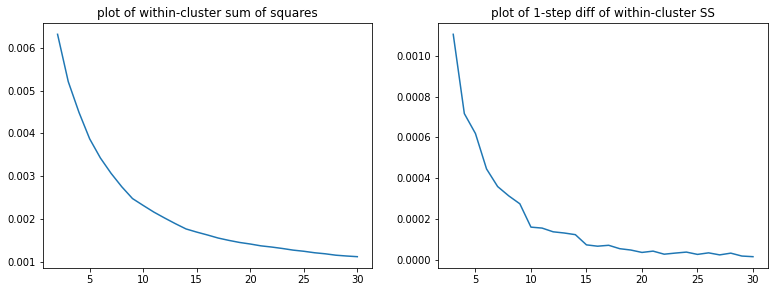

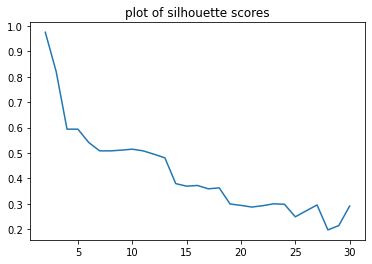

In [25]:
def find_proper_n_cluster(incremental_trend_df, max_clusters=30, 
                          min_clusters=2, random_seed=42, **kmeans_kwargs):
  """Finds the proper number of K-Means clusters.
     
     This functions doesn't automatically find the best number of clusters, but
     only shows plots of within-cluster sum of squares and Silhuette averages to
     help decide the cluster number.

  Args:
    incremental_trend_df: A dataframe containing incremental trends generated
      from the function 'obtain_incremental_trend'.
    max_clusters: The maximal number of clusters we want to check.
    min_clusters: The minimal number of clusters we want to check.
    random_seed: A random seed to fix the k-means algorithm results.
    **kmeans_kw: Named arguments passed to the KMeans fucntion at each step.

  Returns:
    Two dataframes are returned. They contain within-cluster sum of squares and 
    Silhouette averages at each choice of cluster number respectively.
  """
  np.random.seed(random_seed)
  cluster_data_df = incremental_trend_df.transpose()
  ss = []
  silhouette_avgs = []
  num_cluster_choices = range(min_clusters, max_clusters + 1)
  for nc in num_cluster_choices:
    temp_km = KMeans(n_clusters=nc,
                     random_state=np.random.randint(0, 1e5),
                     **kmeans_kwargs).fit(cluster_data_df)
    temp_ss = temp_km.inertia_
    temp_labels = temp_km.predict(cluster_data_df)
    temp_sa = silhouette_score(cluster_data_df, temp_labels)
    ss.append(temp_ss)
    silhouette_avgs.append(temp_sa)
  ss = pd.Series(ss, index=num_cluster_choices)
  silhouette_avgs = pd.Series(silhouette_avgs, index=num_cluster_choices)
  fig, ax = plt.subplots(ncols=2, figsize=(13, 4.5))
  ax = ax.flatten()
  ss.plot(title='plot of within-cluster sum of squares', ax=ax[0])
  (-ss.diff()).plot(title='plot of 1-step diff of within-cluster SS', ax=ax[1])
  fig = plt.figure()
  silhouette_avgs.plot(title='plot of silhouette scores')
  return ss, silhouette_avgs

ss, sa = find_proper_n_cluster(case_incremental_trends, n_init=50)

## What if we specify more clusters in the trend clustering analysis?

You may wonder what happens if we specify more than 9 clusters in the trend cluster analysis. We try to answer that question here.

By looking at the plot about '1-step diff of within-cluster SS' (<a href='#scrollTo=Il3SwBemPca3'>here</a>), we see that there is a relatively steep drop between step 14 and step 15. Hence we choose 14 as the number of clusters for our analysis in this part.

The trends of the clusters are shown below. 

* The patterns of the largest three clusters are bascially the same as they in the 9-cluster result. 
* The main difference between the two versions is that 'cluster_0' has 400 less counties in this 14-cluster result. Some of these counties are contributing to exsiting clusters, like cluster_1 or cluster_2, and some others are forming up new clusters.
* Some clusters in the 14-cluster result share similar patterns, for example cluster_1 and cluster_3 are both counties with increasing trends, while cluster_3 is slightly more severe.
* The 14-cluster result has more small groups containing less than 5 counties.

Based on these observations, the 9-cluster result is preferred as it is granular enough and easy to interpret.

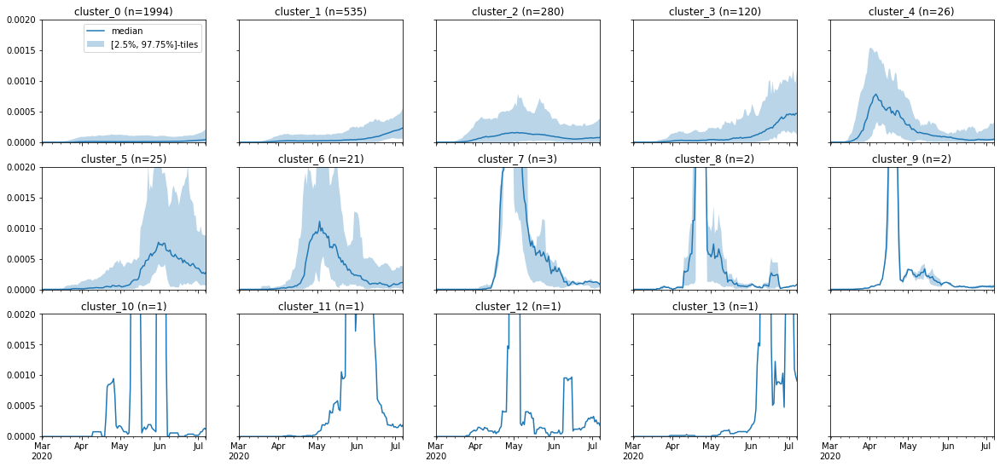

In [26]:
case_cluster_labels_detailed = get_cluster_labels(case_incremental_trends, 14,
                                         random_state=42, n_init=1000)
median_case_trends = plot_cluster_medians(case_incremental_trends, 
                                          case_cluster_labels_detailed,
                                          ylim=[0,0.002])